In [10]:
import pandas as pd
import re
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
import seaborn as sns
import plotly.express as px

In [2]:
df = pd.read_csv("../data/merged_output_sample.csv")
# filter out non-English market products
df = df[df['PriceCurrency'].isin(['USD', 'CAD', 'GBP'])]
df.shape

(837, 30)

In [3]:
category_distribution = df['Category'].value_counts(normalize=True, dropna=False) * 100
categories_over_1_percent = category_distribution[category_distribution > 1]
categories_over_5_percent = category_distribution[category_distribution > 5]
print(f"Number of categories > 1%: {len(categories_over_1_percent)}")
print(f"Number of categories > 5%: {len(categories_over_5_percent)}")

Number of categories > 1%: 13
Number of categories > 5%: 5


We aim to cluster products based on their names and descriptions, and then compare the resulting clusters with the existing product categories. Please note that this analysis is performed on a sample dataset, and we exclude products outside of English-language markets. The use of a sample is intended purely for exploratory purposes and to improve the efficiency of local processing.

### Cluster the products based on product name

Clean up the Name column by lowercasing, removing punctuation, and stopwords.

In [4]:
def preprocess(text):
    text = str(text).lower()
    text = re.sub(r'\W+', ' ', text)
    tokens = [word for word in text.split() if word not in ENGLISH_STOP_WORDS]
    return ' '.join(tokens)

df['clean_name'] = df['Name'].apply(preprocess)

We chose TF-IDF to process the description column because:

- It reduces the impact of common words: Unlike CountVectorizer, TF-IDF down-weights frequently occurring terms (like "the", "shirt", "buy"), which tend to carry less discriminative value.

- It emphasizes informative, distinctive words: Terms that are rare but meaningful (e.g., “velvet”, “vegan”, “leather”) receive higher weights, helping to better differentiate product descriptions.

- It produces a sparse and efficient representation: The resulting matrix is space-efficient and well-suited for unsupervised learning methods like clustering.

At this stage, we focus on term frequency patterns rather than incorporating semantic meaning, which keeps the model simpler and faster.

In [5]:
vectorizer = TfidfVectorizer(max_features=1000)
X = vectorizer.fit_transform(df['clean_name'])

Since we aim to compare the clustering results with the existing categories, we set the number of clusters equal to the number of categories that appear in more than 1% of the sample data.

In [6]:
n_clusters = len(categories_over_1_percent)

Since TF-IDF produces a sparse, high-dimensional, and often orthogonal feature space, KMeans is generally a more suitable choice for initial clustering. It operates efficiently in high-dimensional vector spaces and is less prone to overfitting. In contrast, Gaussian Mixture Models (GMMs) assume an underlying probability distribution and require estimating many parameters (means, covariances), which becomes challenging and unstable in high dimensions — especially when the data is sparse. This can lead to overfitting, increased computational cost, and poor cluster separation.

Moreover, in this context, we’re primarily interested in hard cluster assignments (i.e., assigning each product to a single cluster), rather than the soft probabilistic assignments that GMM provides. This makes KMeans both a simpler and more scalable choice for clustering TF-IDF features.

In [7]:
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['cluster_name'] = kmeans.fit_predict(X)

In [8]:
# Reduce the dimensionality using PCA for visualization (2D)
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X.toarray())

# Add PCA results and cluster labels to the DataFrame
df['PCA1_name'] = X_pca[:, 0]
df['PCA2_name'] = X_pca[:, 1]

In [9]:
# Plot the results
fig = px.scatter(df, x='PCA1_name', y='PCA2_name', color='cluster_name',
                 hover_data={'Pid': True, 'Name': True, 'Category': True, 'Description': False},
                 title="KMeans Clustering of Product Name - 13 Clusters", width = 1000)

# Customize axis labels
fig.update_layout(
    xaxis_title="Principal Component 1",
    yaxis_title="Principal Component 2"
)

# Show the plot
fig.show()

Let's also display the Name and Category columns for each cluster to better understand their composition.

In [10]:
from IPython.display import display, HTML

for cluster_id, group in df.groupby('cluster_name'):
    display(HTML(f"<h4>Cluster {cluster_id} ({len(group)} items):</h4>"))
    html_table = group[['Name', 'Category']].head(10).to_html(index=False, escape=False)
    styled_table = html_table.replace(
        '<table',
        '<table style="font-size:10px; text-align:left; width:100%"'
    )
    display(HTML(styled_table))

Name,Category
"John Richmond Man Sweatshirt Cream Size L Cotton, Polyester",Apparel & Accessories >Clothing >Shirts & Tops
"Dolce & gabbana Man Sweatshirt Purple Size 50 Polyester, Cotton, Polyamide",Apparel & Accessories >Clothing >Shirts & Tops
"O'neill Man T-shirt Sage green Size S Cotton, Lyocell",Apparel & Accessories >Clothing >Shirts & Tops
Tod's Man Ankle boots Midnight blue Size 10 Soft Leather,Apparel & Accessories >Shoes
Soulland Man Shirt White Size S Tencel,Apparel & Accessories >Clothing >Shirts & Tops
Tod's Man Loafers Dark brown Size 7 Soft Leather,Apparel & Accessories >Shoes
"Drumohr Man Pants Ivory Size 42 Cotton, Wool",Apparel & Accessories >Clothing >Pants
"Babe & Tess Infant Girl Pants Sage green Size 9 Cotton, Acetate, Synthetic fibers",Apparel & Accessories >Clothing >Pants
"Theory Man Shorts & Bermuda Shorts Military green Size 29 Cotton, Nylon, Elastane",Apparel & Accessories >Clothing >Shorts
"Represent Man Jeans Black Size 31 Cotton, Elastane",Apparel & Accessories >Clothing >Pants


Name,Category
Olsen Women's Boucle Knit Boat Neck Sweater - Apricot,Apparel & Accessories
Mango Women's Straps Detail High-Heeled Shoes - Black,Apparel & Accessories >Shoes
Nike Men's Court Vision Low Casual Sneakers from Finish Line - Gray Fog/Black,Apparel & Accessories >Shoes
Dockers Men's Castaway Boat Shoe - Raisin,Apparel & Accessories >Shoes
Dockers Men's Vargas Casual Boat Shoes - Rust,Apparel & Accessories >Shoes
Nunn Bush Men's Stance Knit Wingtip Oxford Shoes - Gray Multi,Apparel & Accessories >Shoes
Premiata Man Lace-up shoes Black Size 12 Leather,Apparel & Accessories >Shoes
Premiata Man Lace-up shoes Black Size 7.5 Soft Leather,Apparel & Accessories >Shoes
Women's UA Dynamic Select Training Shoes,NaN
Men's UA Drive Fade Spikeless Golf Shoes,Office Supplies >Office Instruments >Office Rubber Stamps


Name,Category
Fifth Sun Men's Logo Short Sleeve Crew T-shirt - Natural,Apparel & Accessories >Clothing >Shirts & Tops
Women's Concepts Sport Washington Capitals Sunray Multicolor Tri-Blend Tank Top - White,Apparel & Accessories
Clarks Women's Collection Natalyn Step Ballet Flats - Black Leather,Apparel & Accessories >Shoes
Women's Crewneck Word Art Mama Bear Sweatshirt Top - Purple,Apparel & Accessories >Clothing >Shirts & Tops
Marvel Men's Deadpool Tacos Best On Tuesday Short Sleeve T-Shirt - Black,Apparel & Accessories >Clothing >Shirts & Tops
La Pop Art Women's Thanksgiving Word Art Hooded Sweatshirt - Purple,Apparel & Accessories >Clothing >Shirts & Tops
Cutter & Buck Men's Black Army Black Knights Virtue Eco Pique DryTec Polo - Black,Apparel & Accessories
La Pop Art Big Boy's Word Art T-Shirt - 63 Different Genres of Music - Black,Apparel & Accessories >Clothing >Shirts & Tops
Robocop Men's Ocp Omn Consumer Products Distressed Logo Short Sleeve T-Shirt - Black,Apparel & Accessories >Clothing >Shirts & Tops
"Persol Men's Sunglasses, PO3210S - BLACK / GREEN",Apparel & Accessories >Clothing Accessories >Sunglasses


Name,Category
Calvin Klein Essence Solid Cotton Tufted 2-Pc. Bath Rug Set - Silver Gray,Home & Garden >Bathroom Accessories >Bath Mats & Rugs
"Slickblue 72x72 Inch Square Tablecloth Durable Polyester Poplin, Ideal for Dining & Events - Fuchsia",NaN
Mac Glow Play Cushiony Blush - True Harmony,Health & Beauty >Personal Care >Cosmetics >Makeup >Face Makeup
Sunveno Snug Companion Crib Organizer - Green / Tree,Apparel & Accessories >Clothing >Baby & Toddler Clothing
"vidaXL Wall Bar Table Brown Oak 40.2""x17.7""x40.7"" Engineered Wood - Brownoak",Furniture
Perry Ellis Men's Herringbone Linen Blazer - Natural Linen,Apparel & Accessories >Clothing
iDesign Wire and Acacia Wood Serving Tray - Coconut and Acacia,Home & Garden >Kitchen & Dining >Tableware >Serveware >Serving Trays
Safavieh Striped Kilim V STK801Q 3'x5' Area Rug - Red/ Rust,Home & Garden >Decor >Rugs
Dc Comics Boys Youth Retro Marvel Pull Over Hoodie / Hooded Sweatshirt - Charcoal,Apparel & Accessories >Clothing >Shirts & Tops
Alfred Dunner Petite Romancing The Stone Textured Knit Jacket - Rustcopper,Apparel & Accessories


Name,Category
Effy Diamond Rope Chain Link Hoop Earrings (3/8 ct. t.w.) in 14k Gold - 14K Gold,Apparel & Accessories >Jewelry >Earrings
Genevive Cubic Zirconia Sterling Silver White Gold Plated Marquise Cluster Earrings - White,Apparel & Accessories >Jewelry >Earrings
lonna & lilly Gold-Tone 3-Pc. Set Cubic Zirconia & Mother-of-Pearl Heart Love Earrings - White,Apparel & Accessories >Jewelry >Jewelry Sets
Bernardo Footwear Bernardo Veronika Platform Sandal - Gold,Apparel & Accessories >Shoes
"Badgley Mischka Igi Certified Lab Grown Yellow Diamond Pear-Shaped Engagement Ring (2-3/8 ct. t.w.) in 14k White, Yellow or Rose Gold - Rose Gold",Apparel & Accessories >Jewelry >Rings
Muk Luks Women's Butterfly Polyester & Lurex Headband - Ebony/gold,Apparel & Accessories >Clothing Accessories >Hats
Badgley Mischka Certified Lab Grown Emerald-Cut Solitaire Engagement Ring (3 ct. t.w.) in 14k Gold - Rose Gold,Apparel & Accessories >Jewelry >Rings
Pink & White Enamel Checkerboard Heart Stud Earrings - Red/Gold,Apparel & Accessories >Jewelry >Earrings
Sohi Women's Flora Drop Earrings - Gold,Apparel & Accessories >Jewelry >Earrings
Karl Lagerfeld Paris Gold-Tone Karl Kocktail Stud Earrings - Gold,Apparel & Accessories >Jewelry >Earrings


Name,Category
Ray-Ban New Round Optics Eyeglasses Black Frame Clear Lenses Polarized 53-21,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Italia Independent II 5353 030.093 Men's Eyeglasses Green Size 53 (Frame Only) - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Marc Jacobs MARC 132 807 Womens Eyeglasses Black Size 53 (Frame Only) - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Guess GU7892 87W Womens Sunglasses Blue Size 55,Apparel & Accessories >Clothing Accessories >Sunglasses
Chlo CH0198O 008 Womens Eyeglasses Tortoiseshell Size 53 (Frame Only) - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Ralph by Ralph Lauren RA7157U 5263 Womens Eyeglasses Tortoiseshell Size 53 (Frame Only) - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Guess GU50170 028 Womens Eyeglasses Gold Size 56 (Frame Only) - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Tom Ford FT0711 FAUSTO 53E Men's Sunglasses Size 53,Apparel & Accessories >Clothing Accessories >Sunglasses
Tom Ford FT1192 SALTZMAN 52B Womens Sunglasses Size 53,Apparel & Accessories >Clothing Accessories >Sunglasses
Brendel 902419 30 Men's Eyeglasses Grey Size 50 (Frame Only) - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses


Name,Category
Gymax Wiggle Car Ride-on Toy w/ Flashing Wheels for Toddlers & Kids Pink - Red+grey,Toys & Games
Sugift Full Velvet Upholstered Bed Frame with High Headboard - Grey,Furniture >Beds & Accessories >Headboards & Footboards
La Pop Art Butterfly - Men's Word Art Hooded Sweatshirt - Grey,Apparel & Accessories >Clothing >Shirts & Tops
Sutor Mantellassi Man Loafers Light grey Size 7.5 Soft Leather,Apparel & Accessories >Shoes
"Bruno Manetti Man Sweater Sage green Size XL Wool, Cashmere",Apparel & Accessories >Clothing >Shirts & Tops
"Lorena Antoniazzi Woman Sweater Light grey Size 10 Virgin Wool, Cashmere, Silk, Polyester",Apparel & Accessories >Clothing >Shirts & Tops
Boglioli Man Sweater Pastel blue Size L Wool,Apparel & Accessories >Clothing >Shirts & Tops
"Alberta Ferretti Woman Sweater Black Size 2 Cashmere, Virgin Wool",Apparel & Accessories >Clothing >Shirts & Tops
Siyu Woman Coat Light green Size 4 Merino Wool,Apparel & Accessories >Clothing >Outerwear >Coats & Jackets
Barena Man Sweater Steel grey Size XL Merino Wool,Apparel & Accessories >Clothing >Shirts & Tops


Name,Category
"Style & Co Women's Cozy Mock-Neck Long-Sleeve Sweater, Created for Macy's - Veiled Rose",Apparel & Accessories
"Matching Pet Brinkley Plaid Family Pajamas, Created for Macy's - Brinkley Plaid",NaN
"Alfani Men's Mercerized Polo Shirt, Created for Macy's - Neo Navy",Apparel & Accessories
"And Now This Women's Clip-Dot Scoop-Neck Crop Top, Created for Macy's - Saxifrage",Apparel & Accessories
"Style & Co Women's Kendraa Tailor Loafers, Created for Macy's - Wine Sm",Apparel & Accessories >Shoes
"Bar Iii Women's Plaid Open-Front Faux-Double-Breasted Blazer, Created for Macy's - Medium Saddle",Apparel & Accessories
"Club Room Men's Glover Check Dress Shirt, Created for Macy's - Lt Blue/white",Apparel & Accessories
"Style & Co Women's Pima Cotton 3/4-Sleeve Boat-Neck Top, Regular & Petite, Created for Macy's - Deep Black",Apparel & Accessories >Clothing >Shirts & Tops
"Charter Club The Everyday Cotton Printed Sleep Shirt, Created for Macy's - Vineyard",Apparel & Accessories >Clothing >Sleepwear & Loungewear
"Pezley Leather Arm Chair, Created for Macy's - Dark Blue",Furniture


Name,Category
Nautica Jeans Women's Cotton Embroidered Pleated Top - Blue/white,Apparel & Accessories
Freeze Max Women's Cream Lilo and Stitch Hold on Tight Loose Fit Cropped Pullover Sweatshirt - Cream,Apparel & Accessories
Lucky Brand Women's Cable-Stitch Long-Sleeve Cardigan - Dark Black,Apparel & Accessories
Lands' End Men's Recover 5 Pocket Traditional Fit Denim Jeans - Dark shores,Apparel & Accessories >Clothing >Pants
Anthony Veer Men's Bushwick Lace-Up Suede Chukka Boots - Dark Brown,Apparel & Accessories >Shoes
Lands' End Plus Size High Rise Bi Stretch Pintuck Pencil Ankle Pants - Light stone,Apparel & Accessories >Clothing >Pants
X-Ray Men's Denim Jeans - Dark Blue,Apparel & Accessories >Clothing >Pants
Starter Men's Regular-Fit Logo Embroidered Sleeveless Button-Down Baseball Jersey - Royal,Apparel & Accessories >Clothing >Shirts & Tops
Hugo by Hugo Boss Men's Regular-Fit Graphic T-Shirt - White,Apparel & Accessories
Lands' End Men's Tall Short Sleeve Cotton Supima Tee - Radiant navy,Apparel & Accessories >Clothing >Shirts & Tops


Name,Category
Dsquared2 Woman T-shirt Red Size L Cotton,Apparel & Accessories >Clothing >Shirts & Tops
"Diana Gallesi Woman T-shirt White Size 4 Viscose, Polyamide",Apparel & Accessories >Clothing >Shirts & Tops
Pinko Woman Top Blue Size 2 Cotton,Apparel & Accessories >Clothing >Shirts & Tops
"Freddy Woman Sweatshirt Midnight blue Size S Cotton, Elastane",Apparel & Accessories >Clothing >Shirts & Tops
"Pinko Woman Top Rust Size 6 Polyester, Metallic fiber",Apparel & Accessories >Clothing >Shirts & Tops
"Dsquared2 Woman Sweatshirt White Size XS Cotton, Elastane",Apparel & Accessories >Clothing >Shirts & Tops
"Pinko Woman Top Black Size 2 Cotton, Polyester",Apparel & Accessories >Clothing >Shirts & Tops
"Giorgio Armani Woman Sweater Fuchsia Size 2 Cotton, Polyester",Apparel & Accessories >Clothing >Shirts & Tops
"Magda Butrym Woman Top Fuchsia Size 6 Cotton, Viscose",Apparel & Accessories >Clothing >Shirts & Tops
Nicebrand Toddler Girl Sweatshirt Burgundy Size 6 Cotton,Apparel & Accessories >Clothing >Shirts & Tops


Name,Category
Porsche Design P8596 D Men's Sunglasses Blue Size 58,Apparel & Accessories >Clothing Accessories >Sunglasses
Manufacturing Facilities Design & Material Handling: Sixth Edition,Media >Books
Embedded Design using Programmable Gate Arrays,Media >Books
Volatile Compounds in Foods and Beverages (Food Science and Technology),Media >Books
CMOS Digital Integrated Circuits Analysis & Design,Media >Books
"Electronic Design Automation for IC Implementation, Circuit Design, and Process Technology",Media >Books
Statistical Process Control,Media >Books
Information Technology in Healthcare: What Professionals Need to Know,Media >Books
Process Theology: A Guide for the Perplexed,NaN
Fine Woodworking Biennial Design Book,NaN


Name,Category
Lucky Brand Women's Parmin Flat Penny Loafers - Cannellini Leather,Apparel & Accessories >Shoes
Jeffrey Campbell Lavalamp Block-Heel Booties - Brown Suede Combo,Apparel & Accessories >Shoes
London Rag Joham Faux Leather Chelsea Boots - Black,Apparel & Accessories >Shoes
Dr. Scholl's Women's Once Twice Espadrille Platform Sandals - Petal Pink Faux Leather,Apparel & Accessories >Shoes
LifeStride Women's Gio Mary Jane Wedge Pumps - Black Faux Leather,Apparel & Accessories >Shoes
Naturalizer Women's Ingrid Hybrid Penny Loafers - Warm Taupe Faux Nubuck,Apparel & Accessories >Shoes
London Rag Omul Fleece & Faux Leather Boots - Off white,Apparel & Accessories >Shoes
Steve Madden Women's Delancy Mary Jane Loafer Flats - Brown Suede,Apparel & Accessories >Shoes
Dr. Scholl's Women's Time Off Lace Up Platform Sneakers - White/Black Faux Leather,Apparel & Accessories >Shoes
Bella Vita Women's Bindi Shooties - Black Kid Suede Leather,Apparel & Accessories >Shoes


Name,Category
"Oval Full Rim Plastic Men's Glasses Discount Online Brown Size 49, Free Lenses, HSA/FSA Insurance, Blue Light Block Available - SmartBuy Collection",Health & Beauty >Personal Care >Vision Care >Eyeglasses
Oakley OX8052 FUTURITY 805202 Men's Glasses Grey Size 55 - HSA/FSA Insurance - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Persol PO3343V 1208 Men's Glasses Brown Size 51 - Free Lenses - HSA/FSA Insurance - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Gianfranco Ferre GFF0093 004 Men's Glasses Gunmetal Size 48 - Free Lenses - HSA/FSA Insurance - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
HUGO Hugo 1129 08A Men's Glasses Clear Size 50 - Free Lenses - HSA/FSA Insurance - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Emozioni EM 4412 02S4 Womens Glasses Red Size 50 - Free Lenses - HSA/FSA Insurance - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses
Etnia Barcelona Raffaella WH Womens Glasses White Size 54 - Free Lenses - HSA/FSA Insurance - Blue Light Block Available,Health & Beauty >Personal Care >Vision Care >Eyeglasses


We manually examined the grouping of these 13 clusters and made the following observations:

- Cluster 0: Primarily men's bottom wear (pants, shorts, shoes). The existing category system seems to capture this as 'bottom clothing.'
- Cluster 1: A mix of men's and women's shoes.
- Cluster 2: Mostly tops.
- Cluster 3: Home accessories, though the grouping is quite mixed. **This cluster contains significantly more items than others, indicating a potential imbalance and possible overfitting.**
- Cluster 4: Jewelry.
- Cluster 5: Eyeglasses with frames.
- Cluster 6: Wool and cashmere tops. The existing category system can only capture this as 'tops.'
- Cluster 7: Products from Macy’s, mainly grouped by brand/manufacturer information in the product name.
- Cluster 8: Hard to determine.
- Cluster 9: Cotton tops. Very specific cluster.
- Cluster 10: Books.
- Cluster 11: Leather shoes.
- Cluster 12: Eyeglasses again.

From these results, it is clear that **the existing category system works for capturing basic information, but it misses details such as gender, material, and brand**. Additionally, the imbalance observed in Cluster 3, which contains significantly more items than others, suggests the clustering might have overfit. From the plot above, there are also many overlappings. Let's experiment with smaller clusters to address this issue.

In [11]:
n_clusters = len(categories_over_5_percent)
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['cluster_name_2'] = kmeans.fit_predict(X)

# Plot the results
fig = px.scatter(df, x='PCA1_name', y='PCA2_name', color='cluster_name_2',
                 hover_data={'Pid': True, 'Name': True, 'Category': True, 'Description': False},
                 title="KMeans Clustering of Product Name - 5 Clusters", width = 1000)

# Customize axis labels
fig.update_layout(
    xaxis_title="Principal Component 1",
    yaxis_title="Principal Component 2"
)

# Show the plot
fig.show()

# Display the name and category for each cluster (only display the first 10 in each cluster)
for cluster_id, group in df.groupby('cluster_name_2'):
    display(HTML(f"<h4>Cluster {cluster_id} ({len(group)} items):</h4>"))
    html_table = group[['Name', 'Category']].head(10).to_html(index=False, escape=False)
    styled_table = html_table.replace(
        '<table',
        '<table style="font-size:10px; text-align:left; width:100%"'
    )
    display(HTML(styled_table))

Name,Category
Dsquared2 Woman T-shirt Red Size L Cotton,Apparel & Accessories >Clothing >Shirts & Tops
"Diana Gallesi Woman T-shirt White Size 4 Viscose, Polyamide",Apparel & Accessories >Clothing >Shirts & Tops
Pinko Woman Top Blue Size 2 Cotton,Apparel & Accessories >Clothing >Shirts & Tops
"John Richmond Man Sweatshirt Cream Size L Cotton, Polyester",Apparel & Accessories >Clothing >Shirts & Tops
"Freddy Woman Sweatshirt Midnight blue Size S Cotton, Elastane",Apparel & Accessories >Clothing >Shirts & Tops
"Pinko Woman Top Rust Size 6 Polyester, Metallic fiber",Apparel & Accessories >Clothing >Shirts & Tops
"Dolce & gabbana Man Sweatshirt Purple Size 50 Polyester, Cotton, Polyamide",Apparel & Accessories >Clothing >Shirts & Tops
"O'neill Man T-shirt Sage green Size S Cotton, Lyocell",Apparel & Accessories >Clothing >Shirts & Tops
"Dsquared2 Woman Sweatshirt White Size XS Cotton, Elastane",Apparel & Accessories >Clothing >Shirts & Tops
Tod's Man Ankle boots Midnight blue Size 10 Soft Leather,Apparel & Accessories >Shoes


Name,Category
Calvin Klein Essence Solid Cotton Tufted 2-Pc. Bath Rug Set - Silver Gray,Home & Garden >Bathroom Accessories >Bath Mats & Rugs
"Slickblue 72x72 Inch Square Tablecloth Durable Polyester Poplin, Ideal for Dining & Events - Fuchsia",NaN
Fifth Sun Men's Logo Short Sleeve Crew T-shirt - Natural,Apparel & Accessories >Clothing >Shirts & Tops
Mac Glow Play Cushiony Blush - True Harmony,Health & Beauty >Personal Care >Cosmetics >Makeup >Face Makeup
Sunveno Snug Companion Crib Organizer - Green / Tree,Apparel & Accessories >Clothing >Baby & Toddler Clothing
"vidaXL Wall Bar Table Brown Oak 40.2""x17.7""x40.7"" Engineered Wood - Brownoak",Furniture
Perry Ellis Men's Herringbone Linen Blazer - Natural Linen,Apparel & Accessories >Clothing
Effy Diamond Rope Chain Link Hoop Earrings (3/8 ct. t.w.) in 14k Gold - 14K Gold,Apparel & Accessories >Jewelry >Earrings
iDesign Wire and Acacia Wood Serving Tray - Coconut and Acacia,Home & Garden >Kitchen & Dining >Tableware >Serveware >Serving Trays
Safavieh Striped Kilim V STK801Q 3'x5' Area Rug - Red/ Rust,Home & Garden >Decor >Rugs


Name,Category
Women's Concepts Sport Washington Capitals Sunray Multicolor Tri-Blend Tank Top - White,Apparel & Accessories
Lucky Brand Women's Parmin Flat Penny Loafers - Cannellini Leather,Apparel & Accessories >Shoes
Nautica Jeans Women's Cotton Embroidered Pleated Top - Blue/white,Apparel & Accessories
Clarks Women's Collection Natalyn Step Ballet Flats - Black Leather,Apparel & Accessories >Shoes
Olsen Women's Boucle Knit Boat Neck Sweater - Apricot,Apparel & Accessories
Marvel Men's Deadpool Tacos Best On Tuesday Short Sleeve T-Shirt - Black,Apparel & Accessories >Clothing >Shirts & Tops
Mango Women's Straps Detail High-Heeled Shoes - Black,Apparel & Accessories >Shoes
"Style & Co Women's Cozy Mock-Neck Long-Sleeve Sweater, Created for Macy's - Veiled Rose",Apparel & Accessories
Cutter & Buck Men's Black Army Black Knights Virtue Eco Pique DryTec Polo - Black,Apparel & Accessories
"And Now This Women's Clip-Dot Scoop-Neck Crop Top, Created for Macy's - Saxifrage",Apparel & Accessories


Name,Category
The Epic Guide to Agile: More Business Value on a Predictable Schedule with Scrum (Paperback or Softback),Media >Books
"The World of Mathematics, Vol. 1 Format: Paperback",Media >Books
The Thoth Companion: The Key to the True Symbolic Meaning of the Thoth Tarot (Paperback),NaN
Close to Famous (Paperback) by Joan Bauer,NaN
"Dragon Ball (3-In-1 Edition), Volume 14: Includes Vols. 40, 41 & 42 (Paperback or Softback)",NaN
Learning Astrology (Paperback),NaN
The Elohist (Paperback or Softback),NaN
Miami: The Magic City (Paperback),NaN
Helvetica Standard e Format: Paperback,NaN
The Workbook on the Seven Deadly Sins (Paperback or Softback),NaN


Name,Category
Women's Crewneck Word Art Mama Bear Sweatshirt Top - Purple,Apparel & Accessories >Clothing >Shirts & Tops
La Pop Art Women's Thanksgiving Word Art Hooded Sweatshirt - Purple,Apparel & Accessories >Clothing >Shirts & Tops
La Pop Art Big Boy's Word Art T-Shirt - 63 Different Genres of Music - Black,Apparel & Accessories >Clothing >Shirts & Tops
San Francisco Bridge - Big Girl's Word Art Crewneck Sweatshirt - Royal,Apparel & Accessories >Clothing >Shirts & Tops
Big Girl's Word Art Long Sleeve T-Shirt - Alien - Black,Apparel & Accessories >Clothing >Shirts & Tops
La Pop Art Girls Stretching Cat Word Art Long Sleeve T-Shirt - Black,Apparel & Accessories
Boy's Word Art Hooded Sweatshirt - Pumpkin - Black,Apparel & Accessories >Clothing >Shirts & Tops
"Courtside Market Dream Field 20"" x 24"" Gallery-Wrapped Canvas Wall Art - Multi","Home & Garden >Decor >Artwork >Posters, Prints, & Visual Artwork"
La Pop Art Butterfly - Men's Word Art Hooded Sweatshirt - Grey,Apparel & Accessories >Clothing >Shirts & Tops
"David Lloyd Glover Carmel By the Sea Canvas Art - 20"" x 25"" - Multi","Home & Garden >Decor >Artwork >Posters, Prints, & Visual Artwork"


Based on the plot above, the overlap between products appears to have improved, indicating a more accurate clustering. **However, we may still be underestimating the importance of more detailed information.** This is where **contextual embeddings** can play a crucial role in refining our approach, as they can better capture the nuanced relationships between product descriptions and attributes.

### Cluster the products based on product description

Clean up the `Description` column by lowercasing, removing punctuation, and stopwords.

In [12]:
df['clean_description'] = df['Description'].apply(preprocess)

In [13]:
vectorizer = TfidfVectorizer(max_features=1000)
X = vectorizer.fit_transform(df['clean_description'])

In [14]:
n_clusters = len(categories_over_1_percent)
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['cluster_description'] = kmeans.fit_predict(X)

In [15]:
# Reduce the dimensionality using PCA for visualization (2D)
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X.toarray())

# Add PCA results and cluster labels to the DataFrame
df['PCA1_description'] = X_pca[:, 0]
df['PCA2_description'] = X_pca[:, 1]

In [20]:
# Plot the results
fig = px.scatter(df, x='PCA1_description', y='PCA2_description', color='cluster_description',
                 hover_data={'Pid': True, 'Name': True, 'Category': True, 'Description': False},
                 title="KMeans Clustering of Product Descriptions - 13 Clusters", width=1000)

# Customize axis labels
fig.update_layout(
    xaxis_title="Principal Component 1",
    yaxis_title="Principal Component 2"
)

# Show the plot
fig.show()

In [19]:
n_clusters = len(categories_over_5_percent)
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['cluster_description_2'] = kmeans.fit_predict(X)
# Plot the results
fig = px.scatter(df, x='PCA1_description', y='PCA2_description', color='cluster_description_2',
                 hover_data={'Pid': True, 'Name': True, 'Category': True, 'Description': False},
                 title="KMeans Clustering of Product Descriptions - 5 Clusters", width=1000)

# Customize axis labels
fig.update_layout(
    xaxis_title="Principal Component 1",
    yaxis_title="Principal Component 2"
)

# Show the plot
fig.show()

By examining the clustering plot based on product descriptions, **grouping the products into 5 clusters results in less overlap between product categories.** However, some products from different categories are still grouped together. Despite this, **this clustering approach seems more effective than clustering by product name, as it shows clearer separation between groups and the clusters appear more balanced.**

In [23]:
for cluster_id, group in df.groupby('cluster_description_2'):
    display(HTML(f"<h4>Cluster {cluster_id} ({len(group)} items):</h4>"))
    html_table = group[['Description', 'Category']].head(10).to_html(index=False, escape=False)
    styled_table = html_table.replace(
        '<table',
        '<table style="font-size:10px; text-align:left; width:100%"'
    )
    display(HTML(styled_table))

Description,Category
Iridescent Lorelei with translucent color dances fluidly across the table. Enchanting as a solo act or as part of an ensemble the swirling color adds romance and mystique to any tabletop.,NaN
"jersey, brand logo, print, solid colour with appliqués, round collar, short sleeves , Color: Red , Size: L",Apparel & Accessories >Clothing >Shirts & Tops
"jersey, no appliqués, solid color, v-neck, short sleeves, no pockets, basic tee , Color: White , Size: 4",Apparel & Accessories >Clothing >Shirts & Tops
"broderie anglaise, no appliqués, solid color, v-neck, short sleeves, puffed sleeves, unlined, zipper fastening, without pockets, crop top , Color: Blue , Size: 2",Apparel & Accessories >Clothing >Shirts & Tops
"sweatshirt fleece, brand logo, solid color, crewneck, long sleeves, small sized , Color: Cream , Size: L",Apparel & Accessories >Clothing >Shirts & Tops
"sweatshirt fleece, brand logo, rhinestones, solid color, hooded collar, long sleeves, fleece lining, no pockets, stretch , Color: Midnight blue , Size: S",Apparel & Accessories >Clothing >Shirts & Tops
"crepe, lamé, no appliqués, leopard-print, v-neck, long sleeves, no pockets , Color: Rust , Size: 6",Apparel & Accessories >Clothing >Shirts & Tops
"sweatshirt fleece, brand logo, leopard-print, floral design, hooded collar, long sleeves, unlined, no pockets, large sized , Color: Purple , Size: 50",Apparel & Accessories >Clothing >Shirts & Tops
"jersey, brand logo, solid color with print, round collar, short sleeves, no pockets , Color: Sage green , Size: S",Apparel & Accessories >Clothing >Shirts & Tops
"sweatshirt fleece, brand logo, solid color with print, hooded collar, long sleeves, fleece lining, no pockets , Color: White , Size: XS",Apparel & Accessories >Clothing >Shirts & Tops


Description,Category
Every mother knows the strength and sacrifice it takes to protect their children so we created this amazing word art bear design out of the word mama.,Apparel & Accessories >Clothing >Shirts & Tops
"Show your love for your favorite Dc Comics characters in style with this sweatshirt. All of our designs are officially licensed as part of the Dc Comics merchandise range, making them ideal for fans to celebrate their favorite franchise.",Apparel & Accessories >Clothing >Shirts & Tops
"Lose yourself in the pages of a comic book or the movie adventure of a lifetime with your favorite Marvel superheroes whether you want to swing through the city with Spider-Man, or sail through the air with Iron Man.",Apparel & Accessories >Clothing >Shirts & Tops
"The wiggle car is a great way to keep kids active and develop their skills! Constructed of premium Pp and Pu, this wiggle car can provide miles of enjoyment for kids over two years old. Most importantly, our ride-on toy has many detailed design to ensure the safety for your kids while riding. The designs of 15° dip angle and overhang front wheel can effectively avoid accidental falling. The double triangle structure and low seat base also increase safety for your kids. This wiggle car is suitable for outdoor and indoor play.Features:Pu flashing wheels provide quieter and interesting riding experiencesThe seat is large enough to keep kids wiggling for years to comeA great gift for holidays, birthdays, and other special occasionsThe innovative seamless design adds extra safety features",Toys & Games
Help RoboCop put scum away for good with this officially licensed RoboCop apparel.,Apparel & Accessories >Clothing >Shirts & Tops
"These may look just like the fan-favorite Lands' End traditional fit jeans you know and love, but there's a much deeper story here. A feel-good story where we're putting our best foot forward toward a greener earth and better future. How? Recover denim.",Apparel & Accessories >Clothing >Pants
"Show your love for your favorite Batman characters in style with this T-Shirt. All of our designs are officially licensed as part of the Batman merchandise range, making them ideal for fans to celebrate their favorite franchise.",Apparel & Accessories
"Extraterrestrial life has been the subject of many Movies, Tv Shows, Conspiracy Theories and even first-hand encounters for decades. We pay homage to it with this amazing shirt.",Apparel & Accessories >Clothing >Shirts & Tops
If you own a cat then you know how much they fill your heart and make it complete. Show your love of cats in this unique cat stretching design that is created using the word purr.,Apparel & Accessories
For the extraordinary woman - present her with this original Badgley Mischka lab grown diamond engagement ring showcasing a yellow pear-shaped center stone.,Apparel & Accessories >Jewelry >Rings


Description,Category
"The Calvin Klein essence 2-piece bath rug set is perfect for the modern bathroom. Crafted from 100% cotton, each rug is single sided and features a timeless racetrack design.",Home & Garden >Bathroom Accessories >Bath Mats & Rugs
"This 72x72 inch square tablecloth, made from durable polyester poplin, is designed to provide a stylish and practical solution for your dining and event needs. Its generous size ensures complete coverage for square tables, creating an elegant drape that enhances any setting. The fabric is resistant to wrinkles and stains, offering easy maintenance and long-lasting use, making it perfect for both casual gatherings and formal occasions.",NaN
Rock out with this awesome Fender design T-shirts.,Apparel & Accessories >Clothing >Shirts & Tops
"Show off your Washington Capitals pride in flattering style with this Concepts Sport Sunray tank top. Offering breathable side inserts and ultra-soft tri-blend material, this is the perfect top to keep you comfortable and refreshed all day long. It features striking Washington Capitals graphics in front of a vibrant striped design to elevate your fandom.",Apparel & Accessories
"Steeped in classic penny loafer appeal, the Parmin flats from Lucky Brand dress up or down as an easy accent to your entire wardrobe.",Apparel & Accessories >Shoes
"Bounce from cheeks to lips! Mac's beloved bouncy blush got a good-for-skin glow up, now with skin-conditioning ingredients, including jojoba and grape seed oils, along with vitamin E for a comfortable and oh-so-smooth application. Tap, build, blend and get tempted to touch all of the glowy shades. No mirror needed! In addition, this fingertip-friendly formula blurs the look of pores! Ready to glow? Let's bounce!",Health & Beauty >Personal Care >Cosmetics >Makeup >Face Makeup
You get detailed style and a drapey structure with this pleated and embroidered top from Nautica Jeans.,Apparel & Accessories
"Keep your baby's essentials in order with our Cozy Buddy Crib Organizer. Available in Fox, Bear, or Tree characters, these organizers are easy to assemble with adjustable straps. Choose high-quality C-Clip hooks or stay put straps for cribs or closet.",Apparel & Accessories >Clothing >Baby & Toddler Clothing
This modern wall bar table is distinguished by a simple yet stylish style,Furniture
Add a timeless touch to your look with this button-front linen blazer from Perry Ellis.,Apparel & Accessories >Clothing


Description,Category
"Good condition. English and Mandarin Chinese edition. A copy that has been read but remains intact. May contain markings such as bookplates, stamps, limited notes and highlighting, or a few light stains. Bundled media such as CDs, DVDs, floppy disks or access codes may not be included.",Media >Books
"This item is in overall good condition. Covers and dust jackets are intact but may have minor wear including slight curls or bends to corners as well as cosmetic blemishes including stickers. Pages are intact but may have minor highlighting/ writing. Binding is intact; however, spine may have slight wear overall. Digital codes may not be included and have not been tested to be redeemable and/or active. Minor shelf wear overall. Please note that all items are donated goods and are in used condition. Orders shipped Monday through Friday! Your purchase helps put people to work and learn life skills to reach their full potential. Orders shipped Monday through Friday. Your purchase helps put people to work and learn life skills to reach their full potential. Thank you!",Media >Books
"Good condition. This is the average used book, that has all pages or leaves present, but may include writing. Book may be ex-library with stamps and stickers. 0.71",Media >Books
"Buy with confidence! Book is in acceptable condition with wear to the pages, binding, and some marks within 1.25",Media >Books
"Gently used with minimal wear on the corners and cover. A few pages may contain light highlighting or writing, but the text remains fully legible. Dust jacket may be missing, and supplemental materials like CDs or codes may not be included. Could have library markings. Ships promptly!",Media >Books
Book is in Used-VeryGood condition. Pages and cover are clean and intact. Used items may not include supplementary materials such as CDs or access codes. May show signs of minor shelf wear and contain very limited notes and highlighting. 3.13,Media >Books
"Item in good condition. Textbooks may not include supplemental items i.e. CDs, access codes etc.",Media >Books
Book is in NEW condition. 0.44,Media >Books
Unread book in perfect condition.,Media >Books
"Item in good condition. Textbooks may not include supplemental items i.e. CDs, access codes etc.",Media >Books


Description,Category
"These authentic Italia Independent II 5353 030.093 eyeglasses have Green Plastic frames and are available online for a discounted price at SmartBuyGlasses. Italia Independent eyeglasses are the perfect way to shield eyes from harmful UV rays whilst staying a step ahead of the fashion curve. Collection: Men 2018. Size: 53. Condition: new. Complimentary: anti-scratch coating, anti-reflective coating and UV protection coating. Warranty: 24 months. UPC: EG461510. Authencity guaranteed.",Health & Beauty >Personal Care >Vision Care >Eyeglasses
These authentic Porsche Design P8596 D sunglasses have Blue Plastic frames and are available online for a discounted price at SmartBuyGlasses. Porsche Design sunglasses are the perfect way to shield eyes from harmful UV rays whilst staying a step ahead of the fashion curve. Lens color: Grey. Lens material: Plastic. Collection: Men 2018. Size: 58. Condition: new. Warranty: 24 months. UPC: 4046901829759. Authencity guaranteed.,Apparel & Accessories >Clothing Accessories >Sunglasses
"These authentic Marc Jacobs MARC 132 807 eyeglasses have Black Plastic frames and are available online for a discounted price at SmartBuyGlasses. Marc Jacobs eyeglasses are the perfect way to shield eyes from harmful UV rays whilst staying a step ahead of the fashion curve. Collection: Women 2018. Size: 53. Condition: new. Complimentary: anti-scratch coating, anti-reflective coating and UV protection coating. Warranty: 24 months. UPC: EG340691. Authencity guaranteed.",Health & Beauty >Personal Care >Vision Care >Eyeglasses
These authentic Guess GU7892 87W sunglasses have Blue Plastic frames and are available online for a discounted price at SmartBuyGlasses. Guess sunglasses are the perfect way to shield eyes from harmful UV rays whilst staying a step ahead of the fashion curve. Lens color: Blue Gradient. Lens material: Plastic. Collection: Women 2018. Size: 55. Condition: new. Warranty: 24 months. UPC: SG627845. Authencity guaranteed.,Apparel & Accessories >Clothing Accessories >Sunglasses
"These authentic Chlo CH0198O 008 eyeglasses have Tortoiseshell Plastic frames and are available online for a discounted price at SmartBuyGlasses. Chlo eyeglasses are the perfect way to shield eyes from harmful UV rays whilst staying a step ahead of the fashion curve. Collection: Women 2018. Size: 53. Condition: new. Complimentary: anti-scratch coating, anti-reflective coating and UV protection coating. Warranty: 24 months. UPC: EG652631. Authencity guaranteed.",Health & Beauty >Personal Care >Vision Care >Eyeglasses
"These authentic Ralph by Ralph Lauren RA7157U 5263 eyeglasses have Tortoiseshell Plastic frames and are available online for a discounted price at SmartBuyGlasses. Ralph by Ralph Lauren eyeglasses are the perfect way to shield eyes from harmful UV rays whilst staying a step ahead of the fashion curve. Collection: Women 2018. Size: 53. Condition: new. Complimentary: anti-scratch coating, anti-reflective coating and UV protection coating. Warranty: 24 months. UPC: EG658937. Authencity guaranteed.",Health & Beauty >Personal Care >Vision Care >Eyeglasses
"These authentic Guess GU50170 028 eyeglasses have Gold Metal frames and are available online for a discounted price at SmartBuyGlasses. Guess eyeglasses are the perfect way to shield eyes from harmful UV rays whilst staying a step ahead of the fashion curve. Collection: Women 2018. Size: 56. Condition: new. Complimentary: anti-scratch coating, anti-reflective coating and UV protection coating. Warranty: 24 months. UPC: EG691085. Authencity guaranteed.",Health & Beauty >Personal Care >Vision Care >Eyeglasses
These authentic Tom Ford FT0711 FAUSTO 53E sunglasses have frames and are available online for a discounted price at SmartBuyGlasses. Tom Ford sunglasses are the perfect way to shield eyes from harmful UV rays whilst staying a step ahead of the fashion curve. Lens color: Brown Photochromic. Lens material: . Collection: Men 2018. Size: 53. Conditi

### Cluster the products based on images

Let's start by examining the resolutions of a sample set of images.

In [4]:
from PIL import Image
from tqdm import tqdm
import os
from collections import Counter
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from tensorflow.keras import layers, models

In [2]:
# Your image directory
image_folder = '../img/images_100k/'

# Collect all .jpg or .jpeg files
image_files = [os.path.join(image_folder, f) for f in os.listdir(image_folder)
               if f.lower().endswith(('.jpeg'))]

# Initialize resolution bins
resolution_counts = Counter()

# Loop efficiently
for path in tqdm(image_files, desc="Processing JPEG images"):
    try:
        with Image.open(path) as img:
            w, h = img.size
            min_dim = min(w, h)  # use the smaller dimension to categorize

            if min_dim < 50:
                resolution_counts['<50'] += 1
            elif 50 <= min_dim < 100:
                resolution_counts['50-100'] += 1
            elif 100 <= min_dim < 150:
                resolution_counts['100-150'] += 1
            else:
                resolution_counts['>150'] += 1
    except Exception:
        resolution_counts['error'] += 1

# Print summary
print("\nJPEG Image Resolution Distribution:")
for category, count in resolution_counts.items():
    print(f"{category}: {count}")

Processing JPEG images: 100%|█████████████████████████████████████████████████████████████████████████████████████████████| 99982/99982 [00:19<00:00, 5062.73it/s]


JPEG Image Resolution Distribution:
50-100: 47007
100-150: 52919
<50: 56


In the following section, we apply basic unsupervised image clustering techniques (**CNN + PCA + KMeans**) to understand the data distribution, explore feature patterns, and assess whether visual similarity is meaningfully captured — all before developing a full image retrieval pipeline. **Clustering during the EDA stage provides high-level visual insight into the dataset and helps us identify any natural groupings or dominant patterns, which is especially valuable when no labels are available.**

We use a Convolutional Neural Network (CNN) to extract meaningful visual features from images. CNNs are effective at capturing spatial hierarchies — such as edges, textures, and shapes — which makes them well-suited for understanding visual similarity beyond raw pixel values. Each image is transformed into a compact feature vector that summarizes its visual content.

However, the feature vectors generated by CNNs are still high-dimensional, which can make subsequent analysis (like clustering) inefficient or noisy. To address this, we apply Principal Component Analysis (PCA) to reduce the dimensionality of these vectors while preserving the most important information. PCA simplifies the feature space, speeds up computation, and reduces noise or redundancy.

Finally, we pass the PCA-reduced feature vectors into the KMeans clustering algorithm, which groups similar images together based on their feature similarity. This allows us to explore natural groupings in the data and identify clusters of visually related images.

In the methods below, wer are loading and processing images in batches of 1000. This approach helps manage memory efficiently and prevents system from crashing when working with large datasets like 100,000 images.

Extracting features: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:54<00:00,  1.83it/s]


Total features shape: (99982, 64)

Cluster 0: 11092 images


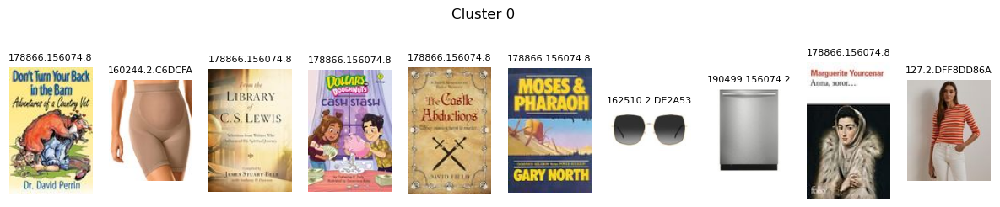


Cluster 1: 7619 images


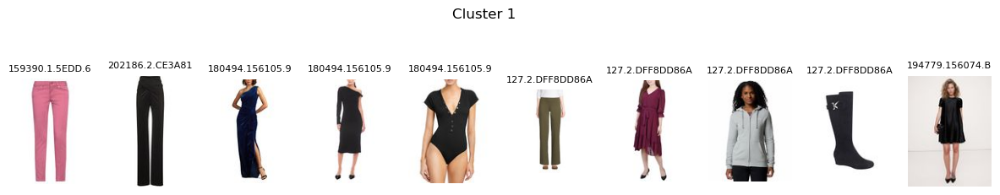


Cluster 2: 6795 images


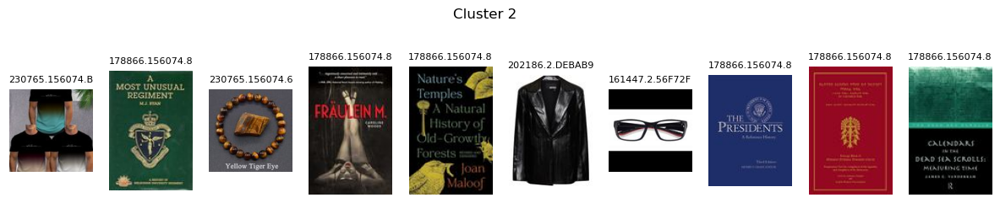


Cluster 3: 5518 images


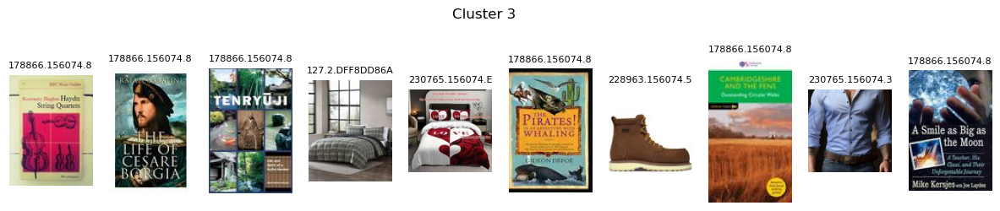


Cluster 4: 5132 images


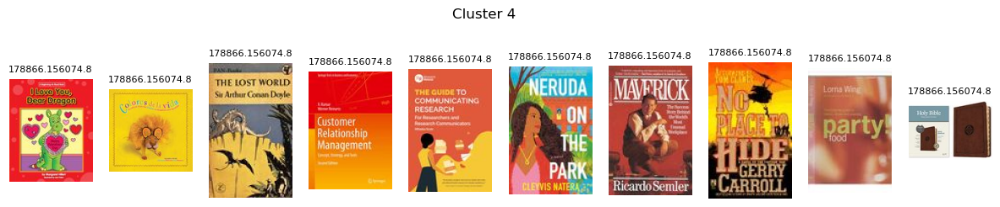


Cluster 5: 8531 images


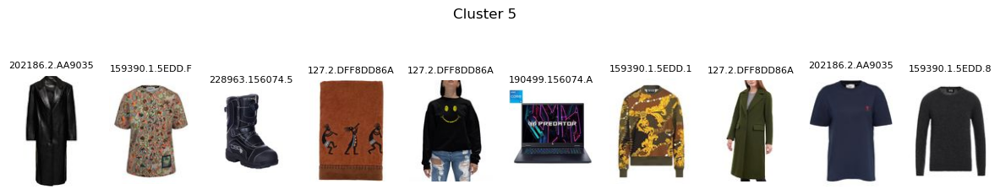


Cluster 6: 10708 images


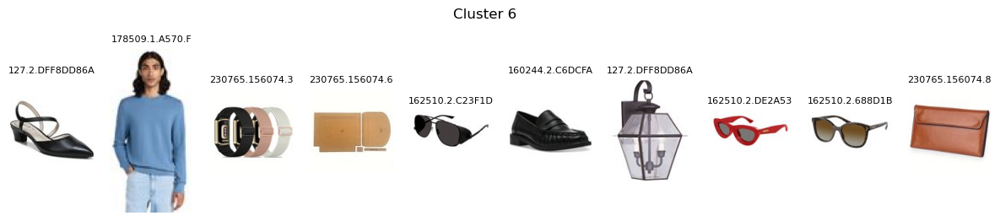


Cluster 7: 8603 images


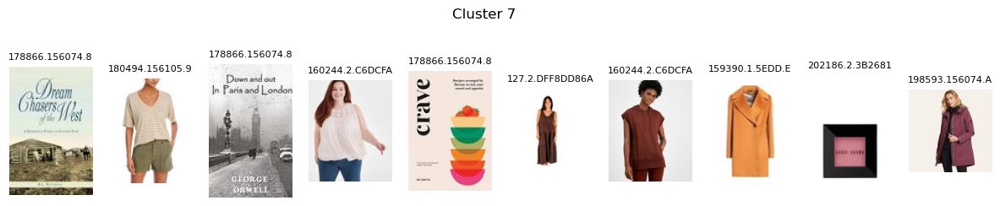


Cluster 8: 27850 images


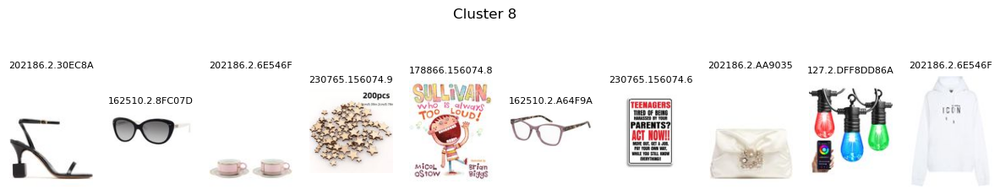


Cluster 9: 8134 images


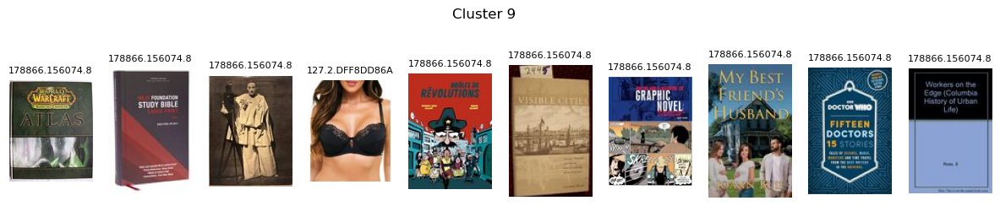

In [11]:
# ========== Step 1: Build CNN ==========
def build_feature_extractor(input_shape=(64, 64, 3)):
    model = models.Sequential([
        layers.Input(shape=input_shape),
        layers.Conv2D(16, (3, 3), activation='relu'),
        layers.MaxPooling2D(),
        layers.Conv2D(32, (3, 3), activation='relu'),
        layers.MaxPooling2D(),
        layers.Flatten(),
        layers.Dense(64, activation='relu')  # Feature vector
    ])
    return model

# ========== Step 2: Batch image loader ==========
def load_image_batch(image_paths, image_size=(64, 64)):
    images = []
    filenames = []
    for path in image_paths:
        try:
            img = Image.open(path).convert('RGB').resize(image_size)
            images.append(np.array(img) / 255.0)
            filenames.append(os.path.basename(path))
        except Exception as e:
            print(f"Error loading {path}: {e}")
    return np.array(images), filenames

# ========== Step 3: Extract features in batches ==========
def extract_features_in_batches(folder_path, batch_size=1000, image_size=(64, 64)):
    cnn_model = build_feature_extractor(input_shape=(64, 64, 3))
    all_features = []
    all_filenames = []

    image_files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.lower().endswith('.jpg') or f.lower().endswith('.jpeg')]
    for i in tqdm(range(0, len(image_files), batch_size), desc="Extracting features"):
        batch_paths = image_files[i:i + batch_size]
        batch_images, batch_names = load_image_batch(batch_paths, image_size=image_size)
        if len(batch_images) == 0:
            continue
        batch_features = cnn_model.predict(batch_images, batch_size=64, verbose=0)
        all_features.append(batch_features)
        all_filenames.extend(batch_names)

    return np.concatenate(all_features), all_filenames

# ========== Step 4: PCA ==========
def reduce_with_pca(features, n_components=50):
    pca = PCA(n_components=n_components, random_state=42)
    return pca.fit_transform(features)

# ========== Step 5: Clustering ==========
def cluster_features(features, n_clusters=10):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    return kmeans.fit_predict(features)

# ========== Step 6: Visualization ==========
def show_cluster_samples(folder_path, filenames, labels, cluster_id, n_samples=10):
    indices = [i for i, l in enumerate(labels) if l == cluster_id][:n_samples]
    plt.figure(figsize=(15, 3))
    for i, idx in enumerate(indices):
        img_path = os.path.join(folder_path, filenames[idx])
        img = Image.open(img_path).convert('RGB')
        plt.subplot(1, n_samples, i+1)
        plt.imshow(img)
        plt.title(filenames[idx][:15], fontsize=8)
        plt.axis('off')
    plt.suptitle(f"Cluster {cluster_id}")
    plt.show()

# ========== Run the pipeline ==========
folder_path = '../img/images_100k/'
features, filenames = extract_features_in_batches(folder_path, batch_size=1000)
print(f"Total features shape: {features.shape}")

pca_features = reduce_with_pca(features, n_components=50)
labels = cluster_features(pca_features, n_clusters=10)

# Count number of images in each cluster
cluster_counts = Counter(labels)

# Loop through each cluster and display 10 samples
for cluster_id in range(10):  # For clusters 0 to 9
    print(f"\nCluster {cluster_id}: {cluster_counts[cluster_id]} images")
    show_cluster_samples(folder_path, filenames, labels, cluster_id=cluster_id, n_samples=10)


Based on the clustering results, Cluster 6 contains 25,469 images, which is more than double the size of most other clusters. **This imbalance suggests that the clustering may be overly influenced by dominant low-level features such as color or general shape, rather than capturing more nuanced distinctions.** Since we did not fine-tune the CNN or perform supervised training, the feature extraction is relatively generic. As a result, the initial clustering may not fully reflect semantic groupings.

However, even with this basic unsupervised approach, **the model is still able to group images with visually similar characteristics — such as books, glasses, tops, or items with similar colors and textures — indicating that the CNN is extracting some meaningful patterns.** This gives us a useful starting point for exploratory analysis and suggests that further improvement could be achieved with more advanced feature extraction or fine-tuning.

**Let's try using a pre-trained model to extract features.**

Since our sample images are all smaller than 150×150 pixels, we choose MobileNetV2 instead of a heavier model like ResNet50. MobileNetV2 is a lightweight and efficient convolutional neural network that allows us to run the pipeline faster on local machines while still extracting rich semantic features from images. These features can then be used for effective clustering and similarity analysis.

Extracting features: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [03:49<00:00,  1.15s/it]


Extracted features shape: (99982, 1280)

Cluster 0: 10950 images


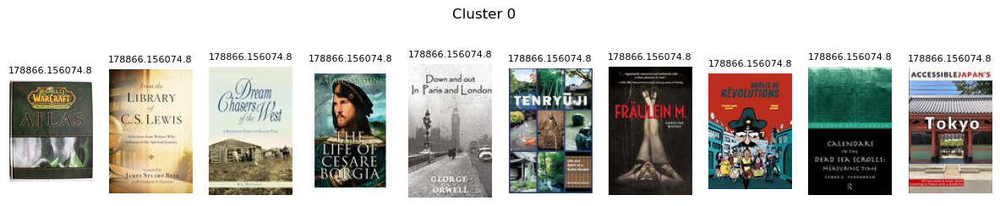


Cluster 1: 5797 images


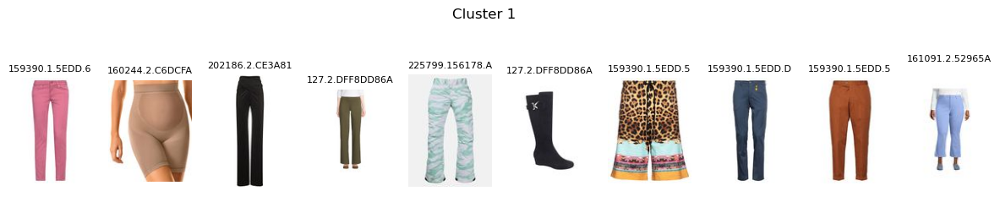


Cluster 2: 7474 images


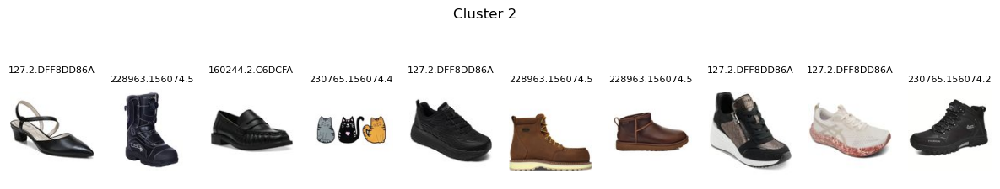


Cluster 3: 9728 images


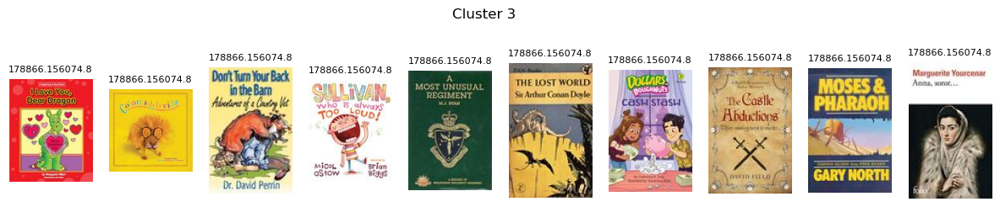


Cluster 4: 7903 images


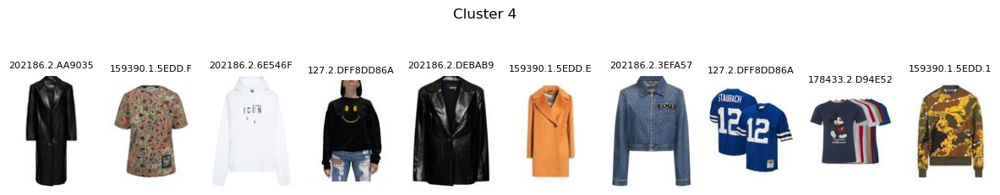


Cluster 5: 12545 images


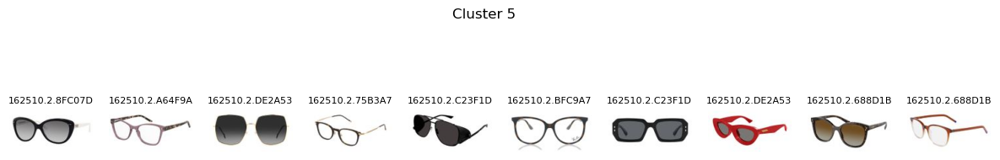


Cluster 6: 9545 images


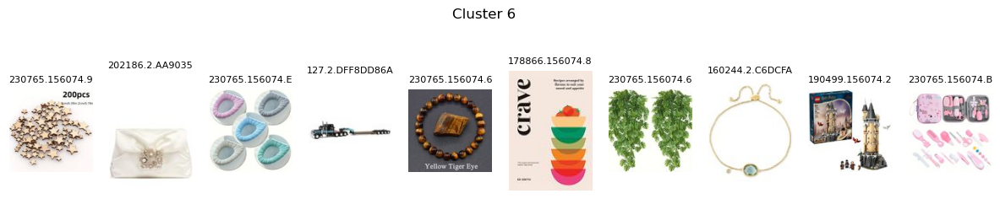


Cluster 7: 12315 images


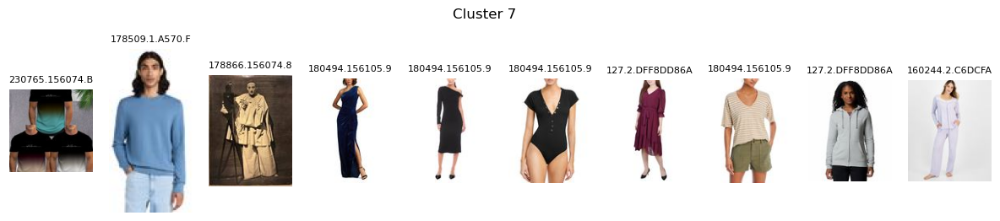


Cluster 8: 13721 images


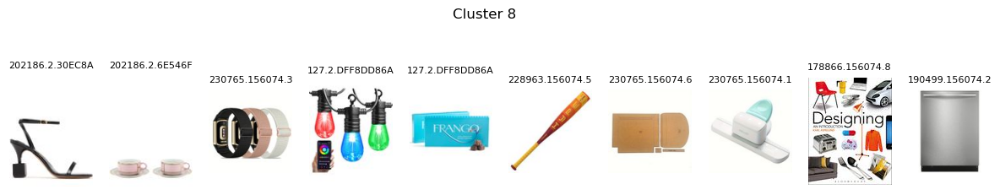


Cluster 9: 10004 images


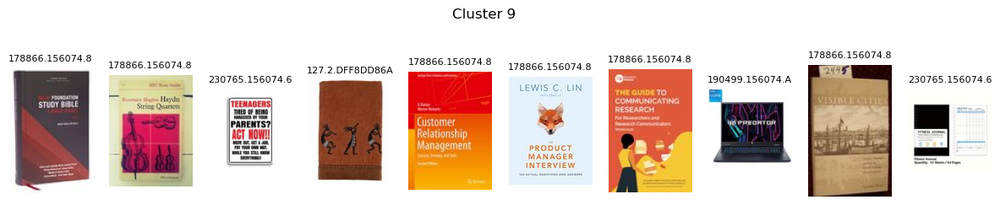

In [14]:
# ========== Step 1: Load Pretrained MobileNetV2 ==========
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Load MobileNetV2 with average pooling
base_model = MobileNetV2(weights='imagenet', include_top=False, pooling='avg', input_shape=(128, 128, 3))
model = Model(inputs=base_model.input, outputs=base_model.output)

# ========== Step 2: Preprocess and Extract Features ==========
def preprocess_mobilenet_image(img_path):
    img = image.load_img(img_path, target_size=(128, 128))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    return preprocess_input(img_array)

def extract_mobilenet_features_in_batches(folder_path, batch_size=500):
    all_features = []
    all_filenames = []
    image_files = [os.path.join(folder_path, f) for f in os.listdir(folder_path)
                   if f.lower().endswith(('.jpg', '.jpeg'))]

    for i in tqdm(range(0, len(image_files), batch_size), desc="Extracting features"):
        batch_paths = image_files[i:i + batch_size]
        batch_images = [preprocess_mobilenet_image(p) for p in batch_paths]
        batch_array = np.vstack(batch_images)
        batch_features = model.predict(batch_array, batch_size=64, verbose=0)
        all_features.append(batch_features)
        all_filenames.extend([os.path.basename(p) for p in batch_paths])

    return np.concatenate(all_features), all_filenames

# ========== Step 3: PCA ==========
def reduce_with_pca(features, n_components=50):
    pca = PCA(n_components=n_components, random_state=42)
    return pca.fit_transform(features)

# ========== Step 4: KMeans Clustering ==========
def cluster_features(features, n_clusters=10):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    return kmeans.fit_predict(features)

# ========== Step 5: Show Sample Clusters ==========
def show_cluster_samples(folder_path, filenames, labels, cluster_id, n_samples=10):
    indices = [i for i, l in enumerate(labels) if l == cluster_id][:n_samples]
    plt.figure(figsize=(15, 3))
    for i, idx in enumerate(indices):
        img_path = os.path.join(folder_path, filenames[idx])
        img = Image.open(img_path).convert('RGB')
        plt.subplot(1, n_samples, i+1)
        plt.imshow(img)
        plt.title(filenames[idx][:15], fontsize=8)
        plt.axis('off')
    plt.suptitle(f"Cluster {cluster_id}")
    plt.show()

# ========== Step 6: Run the Pipeline ==========
folder_path = '../img/images_100k/'
features, filenames = extract_mobilenet_features_in_batches(folder_path, batch_size=500)

print(f"Extracted features shape: {features.shape}")
pca_features = reduce_with_pca(features, n_components=50)
labels = cluster_features(pca_features, n_clusters=10)

# Count number of images in each cluster
cluster_counts = Counter(labels)

# Loop through each cluster and display 10 samples
for cluster_id in range(10):  # For clusters 0 to 9
    print(f"\nCluster {cluster_id}: {cluster_counts[cluster_id]} images")
    show_cluster_samples(folder_path, filenames, labels, cluster_id=cluster_id, n_samples=10)

The cluster imbalance observed in the initial run has significantly improved with the use of MobileNetV2 for feature extraction. We are now able to identify more coherent and meaningful groups within the data. Clear visual patterns have emerged, such as distinct clusters for pants, shoes, coats, tops, and glasses.

A particularly interesting finding is the differentiation between children's books and technical books, highlighting that the model can begin to capture more nuanced differences within categories. **This strengthens the conclusion that image-based similarity detection is not only feasible but also reliable for identifying and grouping visually similar items across diverse categories.**